In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import xml.etree.ElementTree as ET
import os,glob,sys
import pylheV

sns.set() #Set style
sns.set_style('ticks',{'font.family':'serif', 'font.serif':'Times New Roman'})
sns.set_context('paper', font_scale=5.5)
sns.set_palette(sns.color_palette("mako"))

In [2]:
particlesDict = {}


In [3]:
with open("particlesLatex.xml") as f:
    xmlStr = f.read()
    xmlStr = "<root>\n" + xmlStr[:] + "</root>" 
root = ET.fromstring(xmlStr)

In [4]:
for particle in root:
    particleData  = particle.attrib
    pid = int(particleData['id'])
    particlesDict[pid] = {}
    for attr,val in particle.attrib.items():
        try:
            particlesDict[pid][attr] = eval(val) #Try to evaluate attribute
        except:
            particlesDict[pid][attr] = val

In [5]:
#This function remove repeated elements
def rm_repeated_p(vector):
    
    d = []
    out = []
    for i in vector: 
        if i[0] not in d: 
            d.append(i[0])
            out.append(i)
   
    return out

In [6]:
#This functions creates a vector with all generations of a initial particle and give a position for each element
def generationsWposition(particles,y0,initial_index,delta_daughters,delta):
    
    lines = []
    name = particlesDict[abs(e.particles[initial_index].id)]['name']
    if e.particles[initial_index].id < 0:
        if name[len(name)-1] == "+":
            name.replace("+", "-")
        elif name[len(name)-1] == "-":
            name = name.replace("-", "+")
        else:
            name = name + "~"

    gen = [[(initial_index,y0,0,name)],[]]
    #While all of daughters arent final the function searchs for daughters.
    k = 1
    out = False
    while(out == False):
        new_gen = []
        y = y0
        for i in range(len(gen[k-1])):
            #Verifing if the particle isnt final
            if particles[gen[k-1][i][0]].status < 0:
                #Getting the particle's daughters
                daughters = particles[gen[k-1][i][0]].daughters
        
                for j,d in enumerate(daughters):
                
                    pdg_id = particlesDict[abs(e.particles[d].id)]['name']
                    if e.particles[d].id < 0:
                        name = particlesDict[abs(e.particles[d].id)]['antiName']
                    else:
                        name = particlesDict[abs(e.particles[d].id)]['name']
                        
                    new_gen+=[(d,y,i,name)]
                    y = y-delta_daughters
                y = y - delta
                
                        
            #If the particle is final:
            else:
                #Storing the particle in the next generation
                new_gen += [(gen[k-1][i][0],y,i,gen[k-1][i][3])]
                y = y - delta
        #Removing repeated elements
        new_gen = rm_repeated_p(new_gen)
        #print(new_gen)
        #Adding the new generation to the generation vector
        gen[k] += new_gen
        #Verifing if all particles are final
        if all_final(gen[k], particles) == True:
            #It is the last generation
            out = True
        else:
            #Goes to the next generation
            gen.append([])
            k = k + 1
    
    #Removing the empty element
    #gen.pop(len(gen)-1)
            
    return gen
            

    

In [7]:
#This function verifies if all particles in the generation are final
def all_final(gen, particles):
    
    for i in gen:
        
        if particles[i[0]].status < 0:
            return False
        
    return True

In [8]:
#Generating the generation vector for parton level of pp -> t tbar
for e in pylheV.readLHE('Perfect_event1.lhe'):
    gen_t = generationsWposition(e.particles,10000,5,30,40)
    gen_tbar = generationsWposition(e.particles,9700,6,30,40)

In [9]:
#Plot of the parton level of p p -> t tbar
colours = sns.color_palette('mako', 14)
fig = plt.figure(figsize = [50,30], dpi = 300)

#protons labels and lines
plt.annotate('p',(0.05,10003),zorder = 5,fontsize=43)
plt.annotate('p',(0.05,9697),zorder = 5,fontsize=43)
plt.plot([0,1],[10000,9850], marker = 'o', zorder = 0, color = colours[0],linewidth = 3, ms = 10)
plt.plot([0,1],[9700,9850], marker = 'o', zorder = 0, color = colours[0], linewidth = 3, ms = 10)

#Big dot
plt.scatter(1,9850,s = 10000, edgecolor = colours[1], facecolor = 'white', linewidth = 3, zorder = 5)

#Lines big dot to t and tbar
plt.plot([1,2],[9850,10000], zorder = 0, color = colours[2], linewidth = 3)
plt.annotate('t',(2.05,10002),zorder = 5,fontsize=43)
plt.plot([1,2],[9850,9700], zorder = 0, color = colours[2], linewidth = 3)
plt.annotate(r'$\bar{t}$',(2.05,9702),zorder = 5,fontsize=43)

#Circle around b quark 
plt.scatter(6.08,9909,s = 10000, edgecolor = 'red', facecolor = 'white', linewidth = 3, linestyle = '--', zorder = 0)

#Circle around \mu^- 
plt.scatter(6.085,9709,s = 10000, edgecolor = 'orangered', facecolor = 'white', linewidth = 3, linestyle = '--', zorder = 0)

#Event plot
for i in range(7,14):
    if i == 0:
        plt.annotate(gen_t[i][i][3],(2.05+i,gen_t[i][i][1]+2),zorder = 5, fontsize=43)
        plt.annotate(gen_tbar[i][i][3],(2.05+i,gen_tbar[i][i][1]+2),zorder = 5, fontsize=43)
    else:
        if i < 11:
            for g in gen_t[i]:
                mom_index = g[2]
                plt.plot([i-5,i-4],[gen_t[i-1][mom_index][1],g[1]],marker = 'o',zorder = 0, color = colours[i-3],linewidth = 3,ms = 10)
                plt.annotate(g[3],(-3.95+i,g[1]+2),zorder = 5,fontsize=43)
        if i > 9:
            for k in gen_tbar[i]:
                mom_index = k[2]
                plt.plot([i-8,i-7],[gen_tbar[i-1][mom_index][1],k[1]],marker = 'o',zorder = 0, color = colours[i-6],linewidth = 3, markersize = 10)
                plt.annotate(k[3],(-6.95+i,k[1]+2),zorder = 5, fontsize=43)

            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.xticks(range(0,7))
plt.ylim([9300,10050])
plt.xlabel('Generation')
plt.savefig('parton_level.pdf')
plt.show()

In [10]:
#Generating the generation vector for b quark 
for e in pylheV.readLHE('Perfect_event1.lhe'):
    b_quark = generationsWposition(e.particles,10000,847,500,600)


In [11]:
#Plot of the hadronization b + ubar
fig = plt.figure(figsize = [50,70], dpi = 300)

#anti u line
plt.plot([6,7],[10800,10000], marker = 'o', zorder = 0, color = colours[6], linewidth = 3, ms = 10)
plt.annotate(r'$\bar{u}$',(6.05,10802), zorder = 5,fontsize = 43)

#Circle around b quark
plt.scatter(6.05,10002,s = 10000, edgecolor = 'red', facecolor = 'white', linewidth = 3, linestyle = '--', zorder = 0)
#First b tag
plt.annotate(b_quark[0][0][3],(6.05,b_quark[0][0][1]+15),zorder = 5, fontsize=43)

#Plot of the lines and names
for i in range(3,len(b_quark)):
    for j,b in enumerate(b_quark[i]):
        mom_index = b[2]
        plt.plot([i+3,i+4],[b_quark[i-1][mom_index][1],b[1]],marker = 'o',zorder = 0, color = colours[i+3],linewidth = 3, ms =10)
        if i != 3:
            plt.annotate(b[3],(4.05+i,b[1]+15),zorder = 5,fontsize=43)
            

plt.tick_params(labelleft=False, left=False)
plt.xticks(range(6,14))
plt.xlabel('Generation')
plt.savefig('quark_b.pdf')

plt.show()

In [12]:
#Generating the generation vector to \mu^-
for e in pylheV.readLHE('Perfect_event1.lhe'):
    mu = generationsWposition(e.particles,10000,893,20,30)


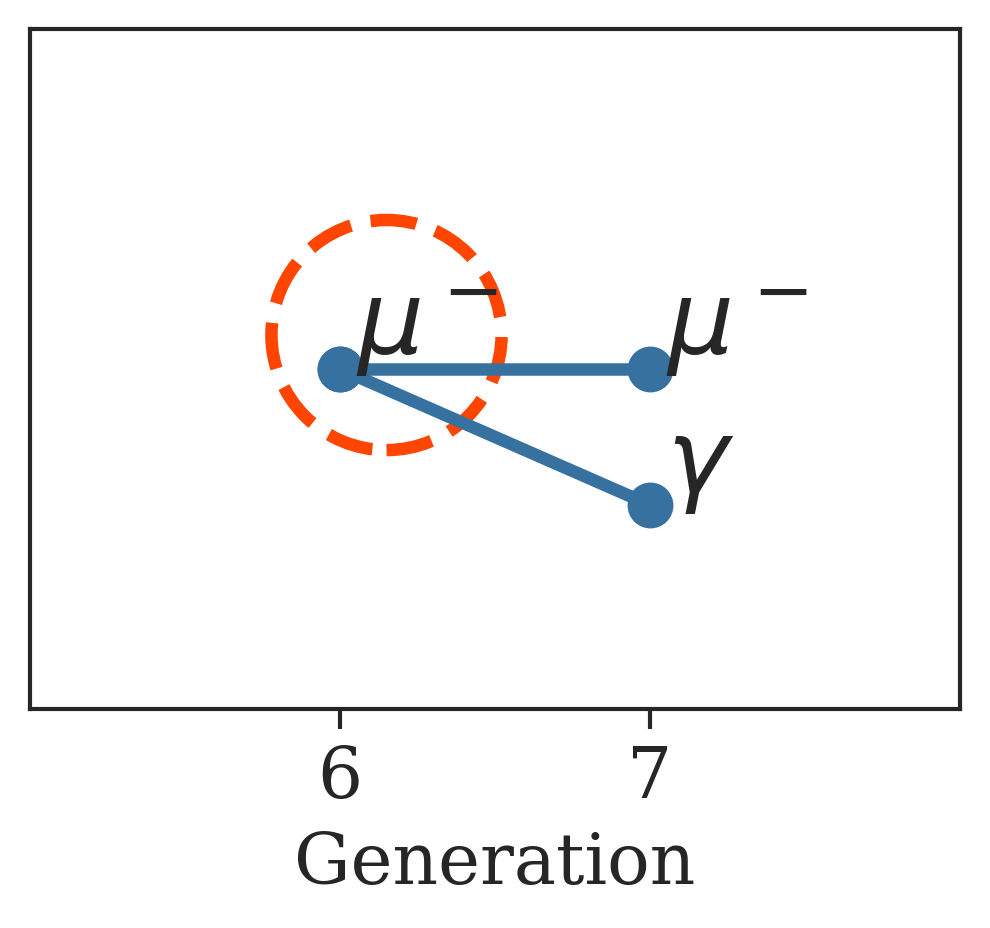

In [13]:
#Plot of a photon emission by the \mu^-
fig = plt.figure(figsize = [4,3], dpi = 300)


#Circle around b quark
plt.scatter(6.15,10005,s = 3050, edgecolor = 'orangered', facecolor = 'white', linewidth = 3, linestyle = '--', zorder = 0)


for i in range(len(mu)):
    if i == 0:
        plt.annotate(mu[i][i][3],(6.05+i,mu[i][i][1]+2),zorder = 5, fontsize=25)
    else:
        for j,m in enumerate(mu[i]):
            mom_index = m[2]
            plt.plot([i+5,i+6],[mu[i-1][mom_index][1],m[1]],marker = 'o',zorder = 0, color = colours[i+5],linewidth = 3, ms =10)
            plt.annotate(m[3],(6.05+i,m[1]+2),zorder = 5,fontsize=25)
            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.ylim([9950,10050])
plt.xlim([5,8])
plt.xticks(range(6,8), fontsize = 17)
plt.xlabel('Generation', fontsize = 17)
plt.savefig('Lepton.pdf')


plt.show()

In [14]:
#Generating the generation vector to all event of a top decay
for e in pylheV.readLHE('single_event.lhe'):
    all_event = generationsWposition(e.particles,10000,5,800,1000)

In [16]:
#Plot of the full top decay
fig = plt.figure(figsize = [50,100], dpi = 300)

colours3 = sns.color_palette('mako', len(all_event)+2)
for i in range(len(all_event)):
    if i == 0:
        plt.annotate(all_event[i][i][3],(0.05+i,all_event[i][i][1]+2), zorder = 5, fontsize=43)
    else:
        for j,g in enumerate(all_event[i]):
            mom_index = g[2]
            plt.plot([i-1,i],[all_event[i-1][mom_index][1],g[1]],marker = 'o', color = colours3[i],linewidth = 3, zorder = 0, ms = 10, alpha = 0.6)
            plt.annotate(g[3],(0.1+i,g[1]+15), zorder = 5, fontsize=43)
            
#plt.yscale('log')
plt.tick_params(labelleft=False, left=False)
plt.xticks(range(0,18))
plt.xlabel('Generation')
plt.savefig('all_event.pdf')
plt.show()